<a href="https://colab.research.google.com/github/LemonZest0/DL-classification/blob/main/dog_vision.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 🐶 End-to-end Multi-class Dog Breed Classification

This notebook builds an end-to-end multi-class image classifier using TensorFlow 2.0 and tensorFlow Hub.

## 1. Problem

Identifying the breed of a dog given an image of a dog.

When I'm sitting at the csfe and I take a photo of a dog, I want to know what breed of dog it is.

## 2. Data

The data we're using is from Kaggle's dog breed identification competition.

https://www.kaggle.com/competitions/dog-breed-identification/data

## 3. Evaluation

The evaluation is a file with prediction probabilities for each dog breed of each test image.

https://www.kaggle.com/competitions/dog-breed-identification/overview/evaluation

## 4. Features

Some information about the unstructured data:
* We're dealing with images (unstructured data) so it's probably best we use deep learning/transfer learning.
* There are 120 breeds of dogs (this means there are 120 different classes).
* There are aound 10,000+ images in the training set (These images have labels)
* There are around 10,000+ images in the test set (These images have no labels, because we'll want to predict them).


In [1]:
# Unzip the uploaded data into Google Drive
# !unzip "drive/MyDrive/Dog Vision/Dog-Breed.zip" -d "drive/MyDrive/Dog Vision"

### Get our workspace ready
* Import TensorFlow 2.x ✅
* Import TensorFlow Hub ✅
* Make sure we are using a GPU ✅

In [2]:
# Import TensorFlow into Colab
import tensorflow as tf
import tensorflow_hub as hub
print("TF version:", tf.__version__)
print("TF hub version:", hub.__version__)

# Check for GPU availability
print("GPU", "available (YESSSSS!!!!!!)" if tf.config.list_physical_devices("GPU") else "not available :(")

TF version: 2.9.2
TF hub version: 0.12.0
GPU available (YESSSSS!!!!!!)


### Getting data ready

Since much of machine learning is getting your data ready to be used with a machine learning model, we'll take extra care getting it setup.

There are a few ways we could do this. Many of them are detailed in the Google Colab notebook on I/O (input and output).

And because the data we're using is hosted on Kaggle, we could even use the Kaggle API.

This is great but what if the data you want to use wasn't on Kaggle?

One method is to upload it to your Google Drive, mount your drive in this notebook and import the file.

In [3]:
# Running this cell will provide you with a token to link your drive to this notebook
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### Accessing data

Now the data files we're working with are available on our Google Drive, we can start to check it out.

Let's start with labels.csv which contains all of the image ID's and their assosciated dog breed (our data and labels).

In [4]:
# Import labels of our data
import pandas as pd
labels_csv = pd.read_csv("drive/MyDrive/Dog Vision/Dog-Breed/labels.csv")
print(labels_csv.describe())
print(labels_csv.head())

                                      id               breed
count                              10222               10222
unique                             10222                 120
top     000bec180eb18c7604dcecc8fe0dba07  scottish_deerhound
freq                                   1                 126
                                 id             breed
0  000bec180eb18c7604dcecc8fe0dba07       boston_bull
1  001513dfcb2ffafc82cccf4d8bbaba97             dingo
2  001cdf01b096e06d78e9e5112d419397          pekinese
3  00214f311d5d2247d5dfe4fe24b2303d          bluetick
4  0021f9ceb3235effd7fcde7f7538ed62  golden_retriever


In [5]:
labels_csv.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


In [6]:
labels_csv["breed"].value_counts()

scottish_deerhound      126
maltese_dog             117
afghan_hound            116
entlebucher             115
bernese_mountain_dog    114
                       ... 
golden_retriever         67
brabancon_griffon        67
komondor                 67
eskimo_dog               66
briard                   66
Name: breed, Length: 120, dtype: int64

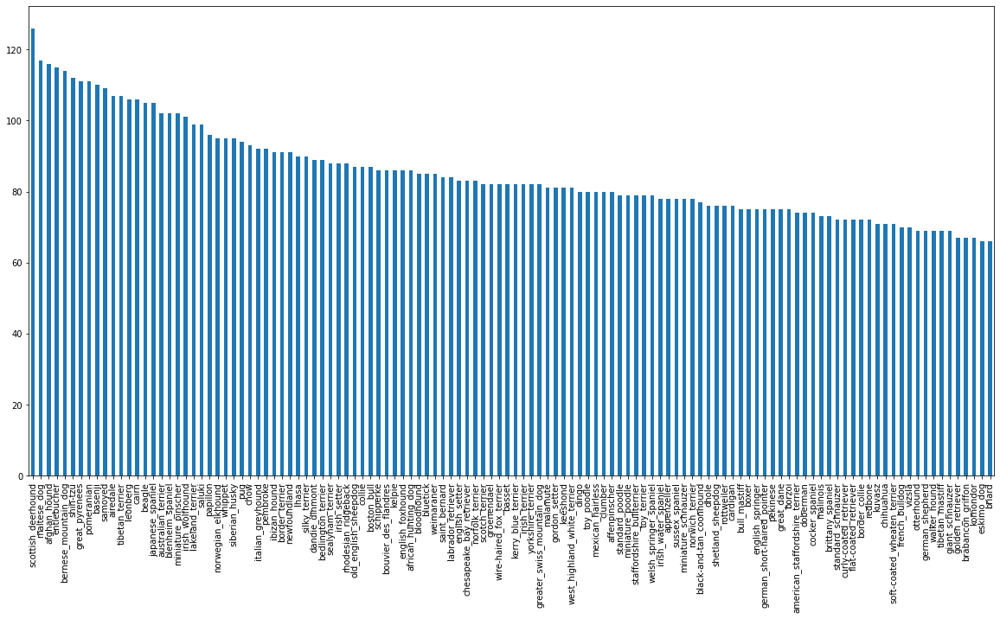

In [7]:
labels_csv["breed"].value_counts().plot(kind="bar",
                                        figsize=(20,10));

Okay sweet. If we were to roughly draw a line across the middle of the graph, we'd see there's about 60+ images for each dog breed.

This is a good amount as for some of their vision products Google recommends a minimum of 10 images per class to get started. And as you might imagine, the more images per class available, the more chance a model has to figure out patterns between them.

In [8]:
labels_csv["breed"].value_counts().mean()

85.18333333333334

In [9]:
labels_csv["breed"].value_counts().median()

82.0

Mean gives more robust values.

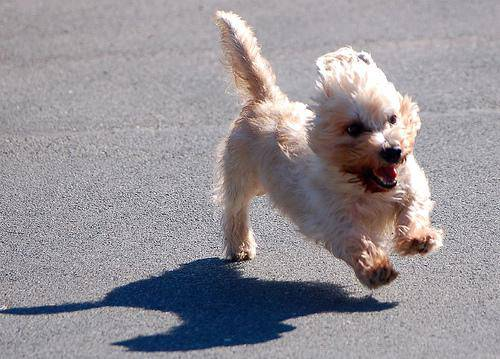

In [10]:
from IPython.display import display, Image
Image("drive/My Drive/Dog Vision/Dog-Breed/train/ffd3f636f7f379c51ba3648a9ff8254f.jpg")

### Getting images and their labels

Since we've got the image ID's and their labels in a DataFrame (`labels_csv`), we'll use it to create:

* A list a filepaths to training images
* An array of all labels
* An array of all unique labels

We'll only create a list of filepaths to images rather than importing them all to begin with. This is because working with filepaths (strings) is much efficient than working with images.

In [11]:
# Create pathname for image ID's
filenames = [fname for fname in labels_csv["id"]]
filenames

['000bec180eb18c7604dcecc8fe0dba07',
 '001513dfcb2ffafc82cccf4d8bbaba97',
 '001cdf01b096e06d78e9e5112d419397',
 '00214f311d5d2247d5dfe4fe24b2303d',
 '0021f9ceb3235effd7fcde7f7538ed62',
 '002211c81b498ef88e1b40b9abf84e1d',
 '00290d3e1fdd27226ba27a8ce248ce85',
 '002a283a315af96eaea0e28e7163b21b',
 '003df8b8a8b05244b1d920bb6cf451f9',
 '0042188c895a2f14ef64a918ed9c7b64',
 '004396df1acd0f1247b740ca2b14616e',
 '0067dc3eab0b3c3ef0439477624d85d6',
 '00693b8bc2470375cc744a6391d397ec',
 '006cc3ddb9dc1bd827479569fcdc52dc',
 '0075dc49dab4024d12fafe67074d8a81',
 '00792e341f3c6eb33663e415d0715370',
 '007b5a16db9d9ff9d7ad39982703e429',
 '007b8a07882822475a4ce6581e70b1f8',
 '007ff9a78eba2aebb558afea3a51c469',
 '008887054b18ba3c7601792b6a453cc3',
 '008b1271ed1addaccf93783b39deab45',
 '008ba178d6dfc1a583617470d19c1673',
 '009509be3ca7cce0ff9e37c8b09b1125',
 '0097c6242c6f3071762d9f85c3ef1b2f',
 '00a338a92e4e7bf543340dc849230e75',
 '00a366d4b4a9bbb6c8a63126697b7656',
 '00a862390341c5be090dd72bd2bc19ef',
 

In [12]:
filenames = ["drive/My Drive/Dog Vision/Dog-Breed/train/" + fname + ".jpg" for fname in labels_csv["id"]]
filenames

['drive/My Drive/Dog Vision/Dog-Breed/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/My Drive/Dog Vision/Dog-Breed/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/My Drive/Dog Vision/Dog-Breed/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/My Drive/Dog Vision/Dog-Breed/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/My Drive/Dog Vision/Dog-Breed/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 'drive/My Drive/Dog Vision/Dog-Breed/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 'drive/My Drive/Dog Vision/Dog-Breed/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 'drive/My Drive/Dog Vision/Dog-Breed/train/002a283a315af96eaea0e28e7163b21b.jpg',
 'drive/My Drive/Dog Vision/Dog-Breed/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 'drive/My Drive/Dog Vision/Dog-Breed/train/0042188c895a2f14ef64a918ed9c7b64.jpg',
 'drive/My Drive/Dog Vision/Dog-Breed/train/004396df1acd0f1247b740ca2b14616e.jpg',
 'drive/My Drive/Dog Vision/Dog-Breed/train/0067dc3eab0b3c3ef0439477624d85d6.jpg',
 'dr

In [13]:
# Check whether number of filenames matches number of actual image files
import os
if (len(os.listdir("drive/My Drive/Dog Vision/Dog-Breed/train")) == len(filenames)):
  print("Filenames match actual amount of files!")
else:
  print("Filenames do not match actual amount of files, check the target directory.")

Filenames match actual amount of files!


Filenames match actual amount of files!

If everything worked, we should see a match up.

Let's do one more check. Visualizing directly from a filepath.

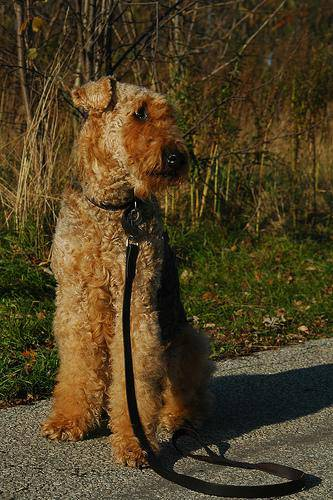

In [14]:
# Visualizing directly from filepath
Image(filenames[5000])

Now we've got our image filepaths together, let's get the labels.

We'll take them from `labels_csv` and turn them into a NumPy array.

In [15]:
import numpy as np
labels = labels_csv["breed"].to_numpy()
labels


array(['boston_bull', 'dingo', 'pekinese', ..., 'airedale',
       'miniature_pinscher', 'chesapeake_bay_retriever'], dtype=object)

In [16]:
len(labels)

10222

Now let's do the same thing as before, compare the number of filenames to the number of labels.

In [17]:
# Check if number of filenames is equal to number of labels
if len(labels) == len(filenames):
  print("Number of labels matches number of filenames!")
else:
  print("Number of labels does not match number of filenames, check data directories.")

Number of labels matches number of filenames!


If it all worked, we should have the same amount of images and labels.

Finally, since a machine learning model can't take strings as input (what labels currently is), we'll have to convert our `labels` to numbers.

To begin with, we'll find all of the unique dog breed names.

Then we'll go through the list of `labels` and compare them to unique breeds and create a list of booleans indicating which one is the real label (`True`) and which ones aren't (`False`).

In [18]:
# Find the unique label values
unique_breeds = np.unique(labels)
len(unique_breeds)

120

The length of `unique_breeds` should be 120, meaning we're working with images of 120 different breeds of dogs.

Now use `unique_breeds` to help turn our `labels` array into an array of booleans.

In [19]:
boolean_labels = [label == unique_breeds for label in labels]
boolean_labels[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [20]:
len(boolean_labels)

10222

That's for one example, now let's do it for the whole thing.

In [21]:
# Turn every label into a boolean array
boolean_labels = [label == np.array(unique_breeds) for label in labels]
boolean_labels[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

### Creating our own validation test

Kaggle did not provide us with any validation set, therefore we will create our ow

We could use Scikit-Learn's train_test_split function or we could simply make manual splits of the data.

For accessibility later, let's save our filenames variable to `X` (data) and our labels to `y`.

In [22]:
# Set up X and y
X = filenames
y = boolean_labels
len(X), len(y)

(10222, 10222)

Since we're working with 10,000+ images, it's a good idea to work with a portion of them to make sure things are working before training on them all.

This is because computing with 10,000+ images could take a fairly long time. And our goal when working through machine learning projects is to reduce the time between experiments.

Let's start experimenting with 1000 and increase it as we need.

In [23]:
# Set number of images to use for experimenting
NUM_IMAGES = 1000 #@param {type:"slider", min:1000, max:10000, step:1000}
NUM_IMAGES

1000

In [24]:
# Import train_test_split from Scikit-Learn
from sklearn.model_selection import train_test_split

# Split data into test and validation set (test size = 80%, validation test = 20%)
X_train, X_val, y_train, y_val = train_test_split(X[:NUM_IMAGES], 
                                                  y[:NUM_IMAGES],
                                                  random_state=42, 
                                                  test_size=0.2)

len(X_train), len(y_train), len(X_val), len(y_val)

(800, 800, 200, 200)

In [25]:
# Check out the training data (image file paths and labels)
X_train[:5], y_train[:2]

(['drive/My Drive/Dog Vision/Dog-Breed/train/00bee065dcec471f26394855c5c2f3de.jpg',
  'drive/My Drive/Dog Vision/Dog-Breed/train/0d2f9e12a2611d911d91a339074c8154.jpg',
  'drive/My Drive/Dog Vision/Dog-Breed/train/1108e48ce3e2d7d7fb527ae6e40ab486.jpg',
  'drive/My Drive/Dog Vision/Dog-Breed/train/0dc3196b4213a2733d7f4bdcd41699d3.jpg',
  'drive/My Drive/Dog Vision/Dog-Breed/train/146fbfac6b5b1f0de83a5d0c1b473377.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False,  True,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
   

### Preprocessing Images (that is converting them into tensors)

Our labels are in numeric format but our images are still just file paths.

Since we're using TensorFlow, our data has to be in the form of Tensors.

A Tensor is a way to represent information in numbers. If you're familar with NumPy arrays (you should be), a Tensor can be thought of as a combination of NumPy arrays, except with the special ability to be used on a GPU.

Because of how TensorFlow stores information (in Tensors), it allows machine learning and deep learning models to be run on GPUs (generally faster at numerical computing).

To preprocess our images into Tensors we're going to write a function which does a few things:

1. Takes an image filename as input.
2. Uses TensorFlow to read the file and save it to a variable, image.
3. Turn our `image` (a jpeg file) into Tensors.
4. Resize the `image` to be of shape (224, 224).
5. Return the modified image.
A good place to read about this type of function is the TensorFlow documentation on loading images.

A good place to read about this type of function is the TensorFlow documentation on loading images.

You might be wondering why (224, 224), which is (heigh, width). It's because this is the size of input our model (we'll see this soon) takes, an image which is (224, 224, 3).

What? Where's the 3 from? We're getting ahead of ourselves but that's the number of colour channels per pixel, red, green and blue.

Let's make this a little more concrete.

Let's see what importing an image looks like

In [26]:
# Convert an image into NumPy array
from matplotlib.pyplot import imread
image = imread(filenames[1])
image.shape

(375, 500, 3)

In [27]:
image[:2]

array([[[ 51,  34,  27],
        [ 55,  38,  30],
        [ 61,  42,  35],
        ...,
        [128,  92,  60],
        [ 78,  42,  10],
        [168, 132, 100]],

       [[ 62,  45,  37],
        [ 64,  45,  38],
        [ 63,  45,  35],
        ...,
        [115,  81,  53],
        [ 46,  12,   0],
        [ 73,  39,  11]]], dtype=uint8)

In [28]:
# turn image into tensor
tf.constant(image)[:2]

<tf.Tensor: shape=(2, 500, 3), dtype=uint8, numpy=
array([[[ 51,  34,  27],
        [ 55,  38,  30],
        [ 61,  42,  35],
        ...,
        [128,  92,  60],
        [ 78,  42,  10],
        [168, 132, 100]],

       [[ 62,  45,  37],
        [ 64,  45,  38],
        [ 63,  45,  35],
        ...,
        [115,  81,  53],
        [ 46,  12,   0],
        [ 73,  39,  11]]], dtype=uint8)>

Now we have seen how images look like after converting them into tensors, let's make a function to prepeocess them.

1. Takes an `image` filename as input.
2. Uses TensorFlow to read the file and save it to a variable, `image`.
3. Turn our `image` (a jpeg file) into Tensors.
4. Normalize tensors that is convert them from range (0,255) to range (0,1).
5. Resize the `image` to be of shape (224, 224).
6. Return the modified `image`. A good place to read about this type of  function is the TensorFlow documentation on loading images.

More information on loading images in TensorFlow can be seen here: https://www.tensorflow.org/tutorials/load_data/images

In [29]:
# Define image size
IMG_SIZE = 224

# Create a function for preprocessing the images
def process_image(image_path, image_size=IMG_SIZE):
  """
  Takes an image file and turns the image into a Tensor.
  """
  # Read in an image file
  image = tf.io.read_file(image_path)
  # Turn jpeg image into numericla Tensor with 3 color channels (Red, Green, Blue)
  image = tf.image.decode_jpeg(image, channels=3)
  # Convert the colour channel values from 0-255 to 0-1
  image = tf.image.convert_image_dtype(image, tf.float32)
  # Resize the image to our desired value(224, 224)
  image = tf.image.resize(image, size=[IMG_SIZE, IMG_SIZE])

  return image

##Turning our data into batches

Why turn our data into batches?

Let's say you're trying to process 10,000+ images in one go... they all might not fit into memory.

So that's why we do about 32 (this is the batch size) images at a time (you can manually adjust the batch size if need be).

In order to use TensorFlow effectively, we need our data in the form of Tensor tuples which look like this: (image, label).

In [30]:
# Create a simple function to return a tuple (image, label)
def get_image_label(image_path, label):
  """
  Takes an image file path name and the assosciated label,
  processes the image and reutrns a typle of (image, label).
  """
  image = process_image(image_path)
  return image, label

In [31]:
# Demo of the above
(process_image(X[42]), tf.constant(y[42]))

(<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
 array([[[0.3264178 , 0.5222886 , 0.3232816 ],
         [0.2537167 , 0.44366494, 0.24117757],
         [0.25699762, 0.4467087 , 0.23893751],
         ...,
         [0.29325107, 0.5189916 , 0.3215547 ],
         [0.29721776, 0.52466875, 0.33030328],
         [0.2948505 , 0.5223015 , 0.33406618]],
 
        [[0.25903144, 0.4537807 , 0.27294815],
         [0.24375686, 0.4407019 , 0.2554778 ],
         [0.2838985 , 0.47213382, 0.28298813],
         ...,
         [0.2785345 , 0.5027992 , 0.31004712],
         [0.28428748, 0.5108719 , 0.32523635],
         [0.28821915, 0.5148036 , 0.32916805]],
 
        [[0.20941195, 0.40692952, 0.25792548],
         [0.24045378, 0.43900946, 0.2868911 ],
         [0.29001117, 0.47937486, 0.32247734],
         ...,
         [0.26074055, 0.48414773, 0.30125174],
         [0.27101526, 0.49454468, 0.32096273],
         [0.27939945, 0.5029289 , 0.32934693]],
 
        ...,
 
        [[0.00634795, 0.03442048

Now we've got a simple function to turn our image file path names and their associated labels into tuples (we can turn these into Tensors next), we'll create a function to make data batches.

Because we'll be dealing with 3 different sets of data (training, validation and test), we'll make sure the function can accomodate for each set.

We'll set a default batch size of 32 because [according to Yann Lecun](https://twitter.com/ylecun/status/989610208497360896?s=20) (one of the OG's of deep learning), friends don't let friends train with batch sizes over 32.

In [32]:
# Define the batch size, 32 is a good default
BATCH_SIZE = 32

# Create a function to turn data into batches
def create_data_batches(x, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):
  """
  Creates batches of data out of images (x) and label (y) pairs.
  Shuffles the data if it's training data but doesn't shuffle if it's validation data.
  Also accepts if it's test data (no labels)
  """
  # If the data is a test dataset, (don't have labels)
  if test_data:
    print("Creating test data batches!!")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x))) #only filepaths
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch

  # If the data is a valid dataset, we do not need to shuffle
  elif valid_data:
    print("Creating valid data batches!!")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x),  # filepaths
                                               tf.constant(y))) # labels
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch

  # If the data is a test dataset, we need to shuffle
  else:
    print("Creating training data batches!!")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x),  # filepaths
                                               tf.constant(y))) # labels
    
    # Shuffling pathnames and labels before mapping image processor function is faster than shuffling images
    data = data.shuffle(buffer_size=len(x))

    # Create (image, label) tuples (turns the image path into preprocessed image)
    data = data.map(get_image_label)

    # Turn data into batches
    data_batch = data.batch(BATCH_SIZE)
    return data_batch

In [33]:
# Creating training and validation dataset batches
training_batch = create_data_batches(X_train, y_train, )
validation_batch = create_data_batches(X_val, y_val, valid_data=True)

Creating training data batches!!
Creating valid data batches!!


In [34]:
# Check out different attributes of our batch datasets
training_batch.element_spec, validation_batch.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

## Visualizing data batches!!
We got our data into batches, more specifically in TENSOR PAIRS of (images, labels) ready for use on a GPU.

But having data into batches can be a bit of a hard concept to understand/comprehend. Therefore let's create a function that helps us visualize what's going on under the hood. 

In [35]:
import matplotlib.pyplot as plt

# Create a function for viewing images in a data batch
def show_25_images(images, labels):
  """
  Displays 25 images from data batch with their labels.
  """
  # Setup the figure
  plt.figure(figsize=(10, 10))
  # Loop through 25 (to display 25 images)
  for i in range(25):
    # Create Subplots (5 rows, 5 columns)
    ax = plt.subplot(5, 5, i+1)
    # Display an image
    plt.imshow(images[i])
    # Add image label as the title
    plt.title(unique_breeds[labels[i].argmax()])
    # Turn grid lines off
    plt.axis("off")

To make computation efficient, a batch is a *tighly wound collection of Tensors*.So to view data in a batch, we've got to *unwind* it.

We can do so by calling the `as_numpy_iterator()` method on a data batch.

This will turn our a data batch into something which can be iterated over.

Passing an iterable to **`next()`** will return the next item in the iterator.

***In our case, next will return a batch of 32 images and label pairs.***

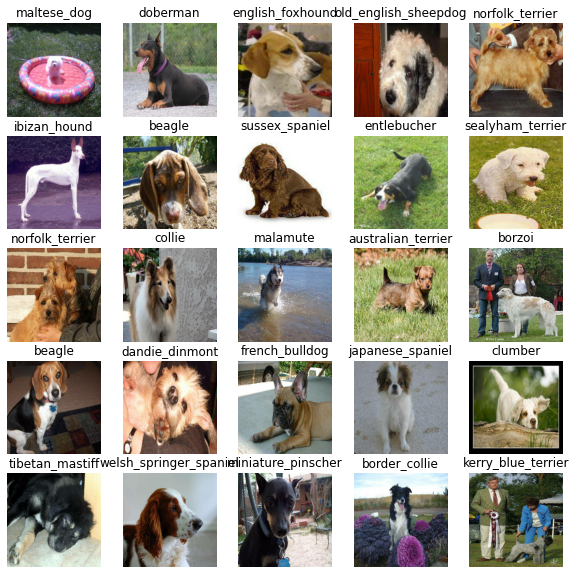

In [36]:
# Visualize training images from the training data batch
train_images, train_labels = next(training_batch.as_numpy_iterator())
show_25_images(train_images, train_labels)

Look at all those beautiful dogs!

**Question**: Rerun the cell above, why do you think a different set of images is displayed each time you run it?

**Answer**: As for training we shuffle to make a batch.

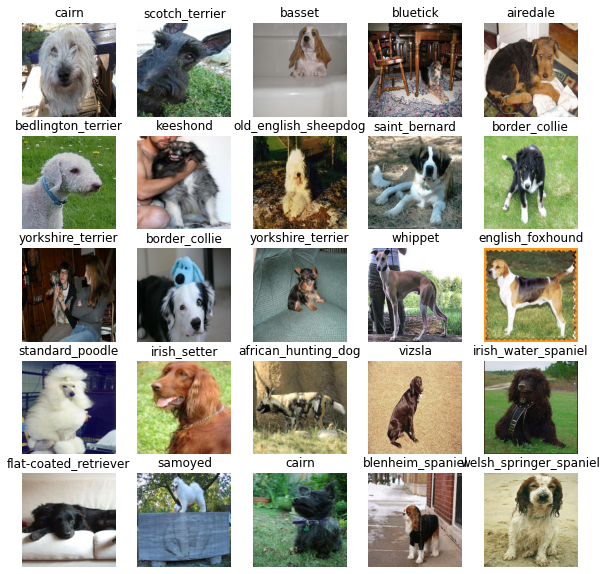

In [37]:
# Visualize a validatation data batch
val_images, val_labels = next(validation_batch.as_numpy_iterator())
show_25_images(val_images, val_labels)

Even more dogs!

**Question:** Why does running the cell above and viewing validation images return the same dogs each time?

**Answer:** We do not shuffle for validation data batch.

## Creating and training a model

Now our data is ready, let's prepare it modelling. We'll use an existing model from [TensorFlow Hub](https://tfhub.dev/).

TensorFlow Hub is a resource where you can find pretrained machine learning models for the problem you are working on.

Using a pretrained machine learning model.

This is often referred to as **transfer learning.**

### Why use a pretrained model?
Building a machine learning model and training it on lots from scratch can be expensive and time consuming.

Transfer learning helps eliviate some of these by taking what another model has learned and using that information with your own problem.

### How do we choose a model?
Since we know our problem is image classification (classifying different dog breeds), we can navigate the [TensorFlow Hub page by our problem domain (image).](https://tfhub.dev/s?module-type=image-augmentation,image-classification,image-feature-vector,image-generator,image-object-detection,image-others,image-style-transfer,image-rnn-agent)

We start by choosing the image problem domain, and then can filter it down by subdomains, in our case, [image classification](https://tfhub.dev/s?module-type=image-classification).

Doing this gives a list of different pretrained models we can apply to our task.

Clicking on one gives us information about the model as well as instructions for using it.

For example, clicking on the [mobilenet_v2_130_224](https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4) model, tells us this model takes an input of images in the shape 224, 224. It also says the model has been trained in the domain of image classification.

### Building a model

Before we build a model, there are a few things we need to define:
 * The **input shape** (our images shape, in the form of Tensors) to our model.
 * The **output shape** (image labels, in the form of Tensors) of our model.
 * The URL of the model we are using from TensorFlow Hub - https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4

***These things will be standard practice with whatever machine learning model you use. And because we're using TensorFlow, everything will be in the form of Tensors.***

Let's try it out.

In [38]:
# Setup input shape to the model
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3] # batch, height, width, colour channels

# Setup output shape of the model
OUTPUT_SHAPE = len(unique_breeds) # number of unique labels

# Setup model URL from TensorFlow Hub
MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4"

Now we've got the inputs, outputs and model we're using ready to go. We can start to put them together

There are many ways of building a model in TensorFlow but one of the best ways to get started is to [use the Keras API](https://www.tensorflow.org/guide/keras/overview).

Defining a deep learning model in Keras can be as straightforward as saying, **"here are the layers of the model, the input shape and the output shape, let's go!"**

Knowing this let's create a function which:

 * Takes the input shape, output shape and the model we've chosen's URL as parameters.
 * Defines the layers in a Keras model in a sequesntial fashion (do this first, then this, then that)
 * Compiles the model (say how it should be evaluated and improved)
 * Builds the model (tells it what kind of input shape it'll be getting)
 * Returns the model.

 Let's code

In [39]:
# Create a function that builds Keras Model
def create_model(input_sahpe = INPUT_SHAPE, output_shape = OUTPUT_SHAPE, model_url = MODEL_URL):
  print("Building model with:", MODEL_URL)

  # Setup the model layers
  model = tf.keras.Sequential([
      hub.KerasLayer(MODEL_URL), # Layer 1 (input layer)
      tf.keras.layers.Dense(units=OUTPUT_SHAPE,
                            activation="softmax") # Layer 2 (output Layer)
  ])

  # Compile the model
  model.compile(
      loss = tf.keras.losses.CategoricalCrossentropy(), # Our model wants to reduce this (how wrong it's guesses are)
      optimizer = tf.keras.optimizers.Adam(), # A friend telling our model how to improve the guesses
      metrics = ["accuracy"] # We'd like this to go up
  )

  # Build the model
  model.build(INPUT_SHAPE) # Let the model know what kind of inputs it'll be getting

  return model

In [40]:
model = create_model()
model.summary()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1001)              5432713   
                                                                 
 dense (Dense)               (None, 120)               120240    
                                                                 
Total params: 5,552,953
Trainable params: 120,240
Non-trainable params: 5,432,713
_________________________________________________________________


## Creating callbacks

Callbacks are helper functions a model can use during training to do such things as save its progress, check its progress or stop training early if a model stops improving.

We will create two callbacks, one for TensorBoard that helps track our models progress and another for early stopping that prevents our model from training for too long i.e. overfitting.


### TensorBoard Callback
To setupp a TensorBoard callback, we need to do 3 things:
1. Load the TensorBoard notebook extension.
2. Create a TensorBoard callback whic is able to save logs to a directory and pass it to our model's `fit()` function.
3. Visualize our models training logs with the `%tensorboard` magic function (we'll do this after model training).

https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/TensorBoard

In [41]:
# Load tensorBoard notebook extension
%load_ext tensorboard

In [42]:
# Function to build a TensorBoard Callback (& save logs to a directory)
import datetime

def create_tensorboard_callback():
  logdir = os.path.join("drive/MyDrive/Dog Vision/logs",
                        # Make it so the logs get tracked everytime we run an experiment
                        datetime.datetime.now().strftime("%d%m%Y-%H%M%S"))
  return tf.keras.callbacks.TensorBoard(logdir)

### Early stopping Callback

Early stopping helps stop our model from overfitting by stopping training if a certain evaluation metric stops improving.

https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/EarlyStopping

In [43]:
# Create a callback for early stopping
early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_accuracy",
                                                  patience=3)

## Training a model (on subset of data)

Our first model is only going to train on 1000 images to make sure that everything is working.

In [44]:
NUM_EPOCH = 100 #@param {type:"slider", min:10, max:100, step:10}

In [45]:
# Check to make we are running on GPU
print("GPU", "available (YESSS!!!!!!!!)" if tf.config.list_physical_devices("GPU") else ("not avilable :("))

GPU available (YESSS!!!!!!!!)


Let's create a function which trains a model.

* Create a model using `create_model()`
* Setup a TensorBoard callback using `create_tensorboard_callback()`
* Call the `fit()` function on our model passing it the training data, validation data, number of epochs to train for `(NUM_EPOCHS)` and the callbacks we'd like to use
* Return the model

In [46]:
# Build a function to train and return a trained model
def train_model():
  """
  Trains a given model and returns the trained versions.
  """
  # Create a model
  model = create_model()

  # Create new TensorBoard session everytime we train a model
  tensorboard = create_tensorboard_callback()

  # Fit the model to the data passing it the callbacks we created
  model.fit(x = training_batch,
            epochs = NUM_EPOCH,
            validation_data = validation_batch,
            validation_freq = 1,
            callbacks = [tensorboard, early_stopping])
  
  # Return the fitted model
  return model

In [47]:
# Fit model to the data
model = train_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Epoch 1/100
25/25 [==============================] - 167s 6s/step - loss: 4.4392 - accuracy: 0.1063 - val_loss: 3.2668 - val_accuracy: 0.2700
Epoch 2/100
25/25 [==============================] - 4s 156ms/step - loss: 1.5501 - accuracy: 0.7113 - val_loss: 2.0557 - val_accuracy: 0.5100
Epoch 3/100
25/25 [==============================] - 3s 132ms/step - loss: 0.5267 - accuracy: 0.9600 - val_loss: 1.5415 - val_accuracy: 0.6050
Epoch 4/100
25/25 [==============================] - 3s 130ms/step - loss: 0.2394 - accuracy: 0.9900 - val_loss: 1.3847 - val_accuracy: 0.6600
Epoch 5/100
25/25 [==============================] - 4s 159ms/step - loss: 0.1417 - accuracy: 0.9987 - val_loss: 1.3249 - val_accuracy: 0.6750
Epoch 6/100
25/25 [==============================] - 3s 133ms/step - loss: 0.0984 - accuracy: 1.0000 - val_loss: 1.2888 - val_accuracy: 0.6700
Epoch 7/100
25/25 [==============================]

### Checking the TensorBoard logs

The TensorBoard magic function (%tensorboard) will acess the logs directory we created earlier and visualize its contents.

In [48]:
%tensorboard --logdir drive/MyDrive/Dog\ Vision/logs

<IPython.core.display.Javascript object>

## Making and evaluting predictions using a trained model

In [49]:
validation_batch

<BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

In [50]:
# Make predictions on the validation data (not used to train on)
predictions = model.predict(validation_batch, verbose=1)
predictions

7/7 [==============================] - 1s 108ms/step


array([[1.5979086e-03, 1.7605021e-04, 1.0822591e-03, ..., 1.3007586e-03,
        4.9860810e-05, 5.5468278e-03],
       [9.2377764e-04, 2.6681120e-04, 5.1319534e-03, ..., 4.4826220e-04,
        1.1827782e-03, 1.7320755e-04],
       [1.7130084e-05, 1.3404867e-05, 2.6971784e-06, ..., 2.9521916e-06,
        2.2045895e-06, 5.2696432e-05],
       ...,
       [2.2364213e-06, 2.1102236e-05, 5.2749987e-05, ..., 4.6349516e-05,
        1.1390118e-04, 4.2964642e-05],
       [2.4822520e-03, 5.6142911e-05, 6.6777247e-05, ..., 5.6372537e-05,
        5.6445326e-05, 7.7507668e-03],
       [4.3627853e-05, 4.2580166e-05, 8.6974615e-04, ..., 1.3898656e-03,
        2.1296785e-04, 4.1985160e-05]], dtype=float32)

In [51]:
predictions[0]

array([1.59790856e-03, 1.76050205e-04, 1.08225911e-03, 2.70268065e-04,
       9.31271294e-04, 1.36428993e-04, 1.11099677e-02, 1.31553435e-03,
       3.17156868e-04, 1.04377940e-02, 8.12698097e-04, 3.60447972e-04,
       1.19529599e-04, 1.39020412e-04, 5.14364336e-04, 1.97123061e-03,
       7.66655285e-05, 3.31547409e-02, 4.06240943e-05, 2.62938032e-04,
       7.12024514e-04, 6.31443472e-05, 9.09190567e-06, 8.01575894e-04,
       1.57571718e-04, 3.10447613e-05, 2.44624734e-01, 5.11377526e-04,
       9.07980546e-04, 8.24483694e-04, 2.99826992e-04, 9.12360090e-04,
       5.58918342e-04, 1.28259780e-04, 1.10558976e-05, 3.54554653e-02,
       1.40047578e-05, 8.43556190e-04, 6.61949394e-04, 5.39300323e-04,
       1.34752586e-03, 6.80324229e-05, 1.31828725e-04, 2.21762908e-04,
       1.48933505e-05, 3.38744067e-05, 3.19190731e-05, 3.01590946e-04,
       2.38871755e-04, 2.90651020e-04, 6.41763618e-05, 2.96662329e-04,
       2.09929259e-03, 1.93318469e-04, 2.65766139e-04, 1.79226015e-04,
      

In [52]:
# Prediction example
index = 42
print(predictions[index])
print(f"Sum (probabilities of index): {np.sum(predictions[index])}")
print(f"Max value (probability of prediction): {np.max(predictions[index])}")
print(f"Index of maximum value: {np.argmax(predictions[index])}")
print(f"Predicted label: {unique_breeds[np.argmax(predictions[index])]}")

[1.75906644e-05 2.40762020e-04 2.91789056e-05 8.53044548e-05
 1.89095363e-03 5.60844128e-05 1.51069195e-04 5.45525108e-04
 1.78749114e-02 6.38857335e-02 2.55628183e-05 9.61581554e-06
 2.49149976e-04 9.66796244e-04 9.63639293e-04 1.22649898e-03
 1.50827400e-05 3.45908018e-04 3.11640673e-04 1.51105065e-04
 4.46204212e-05 3.80328333e-04 3.83846236e-05 2.00617906e-05
 4.87402268e-03 1.66668746e-04 5.54278377e-05 2.85401875e-05
 1.06210595e-04 4.57131209e-05 7.37224109e-05 5.80103697e-05
 8.36952895e-05 1.29795617e-05 1.87158439e-05 6.19317143e-05
 2.20547663e-04 1.17006835e-04 1.42322562e-04 1.46228164e-01
 1.17424468e-04 1.95713983e-05 2.35724961e-03 3.84206760e-06
 1.32534275e-04 5.71640230e-05 1.95017812e-04 1.90760198e-04
 6.31172006e-05 2.56670697e-04 4.93603038e-05 1.65163685e-04
 2.85913207e-04 1.41794677e-03 3.39752223e-05 2.17624911e-04
 3.90270761e-05 5.73726575e-05 1.04497864e-04 4.95932545e-05
 4.04781131e-05 1.41466327e-03 9.63692037e-06 2.80631139e-05
 8.98817307e-05 1.612161

In [53]:
unique_breeds[113]

'walker_hound'

Now let's write a function by which we can apply the above functionality to a larger scale.

And it would be even better if we could see the image the prediction is being made on!

**Note:** Prediction probabilities are also known as **confidence Levels**.

In [54]:
# Turn prediction probabilities into their  respective labels
def get_pred_label(prediction_probabilities):
  """
  Turns an array of prediction probabilities/ confidence levels into a label.
  """
  return unique_breeds[np.argmax(prediction_probabilities)]

# Get predicted label based on an array of prediction probabilities
pred_label = get_pred_label(predictions[index])
pred_label

'walker_hound'

Now since our validation data is still in a batch dataset, we'll have to unbatchify it to make predictions on the validation images and then compare those predictions to the validation labels (truth labels).

In [55]:
# for a single prediction
images_ = []
labels_ = []

# Loop through unbatched data
for image, label in validation_batch.unbatch().as_numpy_iterator():
  images_.append(image)
  labels_.append(label)

images_[0], labels_[0]

(array([[[0.29599646, 0.43284872, 0.3056691 ],
         [0.26635826, 0.32996926, 0.22846507],
         [0.31428418, 0.27701408, 0.22934894],
         ...,
         [0.77614343, 0.82320225, 0.8101595 ],
         [0.81291157, 0.8285351 , 0.8406944 ],
         [0.8209297 , 0.8263737 , 0.8423668 ]],
 
        [[0.2344871 , 0.31603682, 0.19543913],
         [0.3414841 , 0.36560842, 0.27241898],
         [0.45016077, 0.40117094, 0.33964607],
         ...,
         [0.7663987 , 0.8134138 , 0.81350833],
         [0.7304248 , 0.75012016, 0.76590735],
         [0.74518913, 0.76002574, 0.7830809 ]],
 
        [[0.30157745, 0.3082587 , 0.21018331],
         [0.2905954 , 0.27066195, 0.18401104],
         [0.4138316 , 0.36170745, 0.2964005 ],
         ...,
         [0.79871625, 0.8418535 , 0.8606443 ],
         [0.7957738 , 0.82859945, 0.8605655 ],
         [0.75181633, 0.77904975, 0.8155256 ]],
 
        ...,
 
        [[0.9746779 , 0.9878955 , 0.9342279 ],
         [0.99153054, 0.99772066, 0.94278

In [56]:
# Write function for above code (function to unbatch a batch dataset)
def unbatch(data):
  """
  Takes a batched dataset of (image, label) Tensors and returns seperate arrays of image and labels.
  """
  images = []
  labels = []

  # Loop through unbatched data
  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_breeds[np.argmax(label)])
  
  return images, labels

In [57]:
# Unbatch the validation data
val_images, val_labels = unbatch(validation_batch)

In [58]:
val_images[42], val_labels[42]

(array([[[0.38957366, 0.41003576, 0.24668868],
         [0.28490537, 0.3024474 , 0.13166252],
         [0.39421162, 0.40597633, 0.22397445],
         ...,
         [0.44317505, 0.514377  , 0.3641503 ],
         [0.36554822, 0.4306983 , 0.27838323],
         [0.40317073, 0.46244943, 0.3083703 ]],
 
        [[0.3469013 , 0.37179625, 0.19696724],
         [0.44802392, 0.46762645, 0.2893203 ],
         [0.40835413, 0.4211125 , 0.2350509 ],
         ...,
         [0.35259834, 0.43502265, 0.25800505],
         [0.41130486, 0.48331636, 0.3029741 ],
         [0.5206004 , 0.5898823 , 0.4094875 ]],
 
        [[0.5733184 , 0.60469097, 0.414881  ],
         [0.621097  , 0.6504738 , 0.45262858],
         [0.47423595, 0.4946036 , 0.2915352 ],
         ...,
         [0.3783241 , 0.46725255, 0.25363445],
         [0.38703287, 0.46943694, 0.25706223],
         [0.3622422 , 0.44753677, 0.22706969]],
 
        ...,
 
        [[0.29021844, 0.26668903, 0.1744612 ],
         [0.2593909 , 0.22903654, 0.13408

Now we've got ways to get get:

* Prediction labels
* Validation labels (truth labels)
* Validation images

Let's make some function to make these all a bit more visaulize.

#### We will create a function to make these all a bit more visualize.

We will create a function which:

* Takes an array of prediction probabilities, an array of truth labels and an array of images and an integer(index value).
* Convert the prediction probabilities to a predicted label.
* Plot the predicted label, it's predicted probability, truth label and the target image on a single plot. (according to the given index)

In [59]:
# Function to plot predicted label, it's predicted probability, truth label and the target image on a single plot. (according to the given index)
def plot_pred(prediction_probabilities, labels, images, n=0):
  """
  View the predicted label, it's predicted probability, true label and image for sample n
  """
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]

  # Get the pred label
  pred_label = get_pred_label(pred_prob)

  # Plot image & remove ticks
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  # Change the colour of title depending on if the prediction is right or wrong
  colour = "green" if pred_label == true_label else "red"
  
  # Change plot title to be predicted label, probability of prediction and truth label
  plt.title("{} {:2.0f}% {} ".format (pred_label, 
                                      np.max(pred_prob)*100, 
                                      true_label),
                                      color = colour)


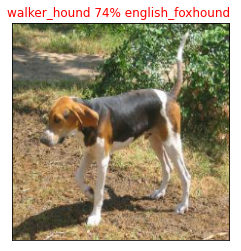

In [60]:
plot_pred(prediction_probabilities=predictions,
          labels=val_labels,
          images=val_images,
          n=42)

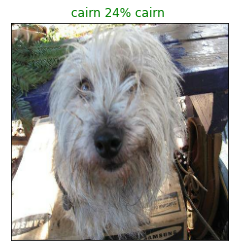

In [61]:
plot_pred(prediction_probabilities=predictions,
          labels=val_labels,
          images=val_images)

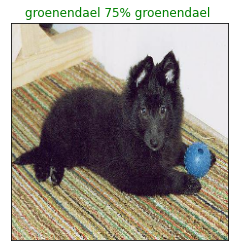

In [62]:
plot_pred(prediction_probabilities=predictions,
          labels=val_labels,
          images=val_images,
          n=77)

Now we've got one function to visualize our models top prediction, let's make another to view our models top 10 predictions.

This function will:

* Take an input of prediction probabilities array and a ground truth array and an integer 
* Find the prediction using get_pred_label() 
* Find the top 10:
  * Prediction probabilities indexes 
  * Prediction probabilities values 
  * Prediction labels 
* Plot the top 10 prediction probability values and labels, coloring the true label green 

In [63]:
# Function to plot top 10 probabilities our model makes for any index n
def plot_pred_conf(prediction_probabilities, labels, n=0):
  """
  Plot the top 10 highest prediction confidences along with the truth label for sample n.
  """
  pred_prob, true_label = prediction_probabilities[n], labels[n]

  # Get the predicted label
  pred_label = get_pred_label(pred_prob)

  # Find the top 10 prediction confidence indexes
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]

  # Find the top 10 prediction confidence values
  top_10_pred_values = pred_prob[top_10_pred_indexes]

  # Find the top 10 prediction labels 
  top_10_pred_labels = unique_breeds[top_10_pred_indexes]

  # Setup plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)),
                     top_10_pred_values,
                     color="grey")
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels = top_10_pred_labels,
             rotation = "vertical")
  
  # Change colour of true_label
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("green")
  else:
    pass

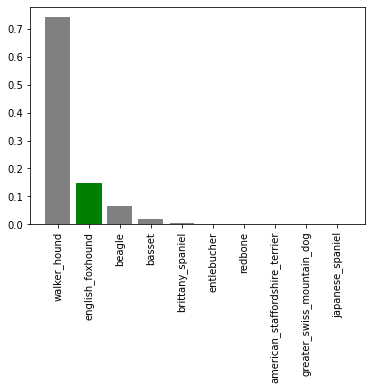

In [64]:
plot_pred_conf(prediction_probabilities=predictions,
               labels=val_labels,
               n=42)

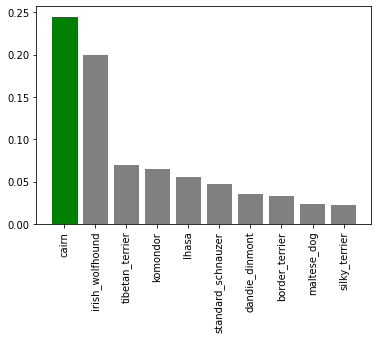

In [65]:
plot_pred_conf(prediction_probabilities=predictions,
               labels=val_labels)

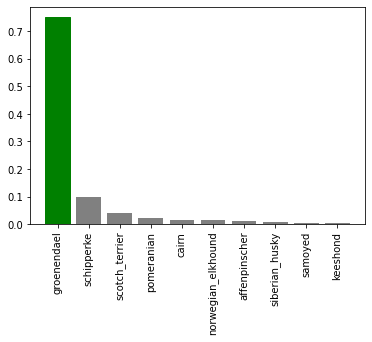

In [66]:
plot_pred_conf(prediction_probabilities=predictions,
               labels=val_labels,
               n=77)

Great!! Now we have got some functions to help us visualize our redictions and evaluate our model, let's check out a few.

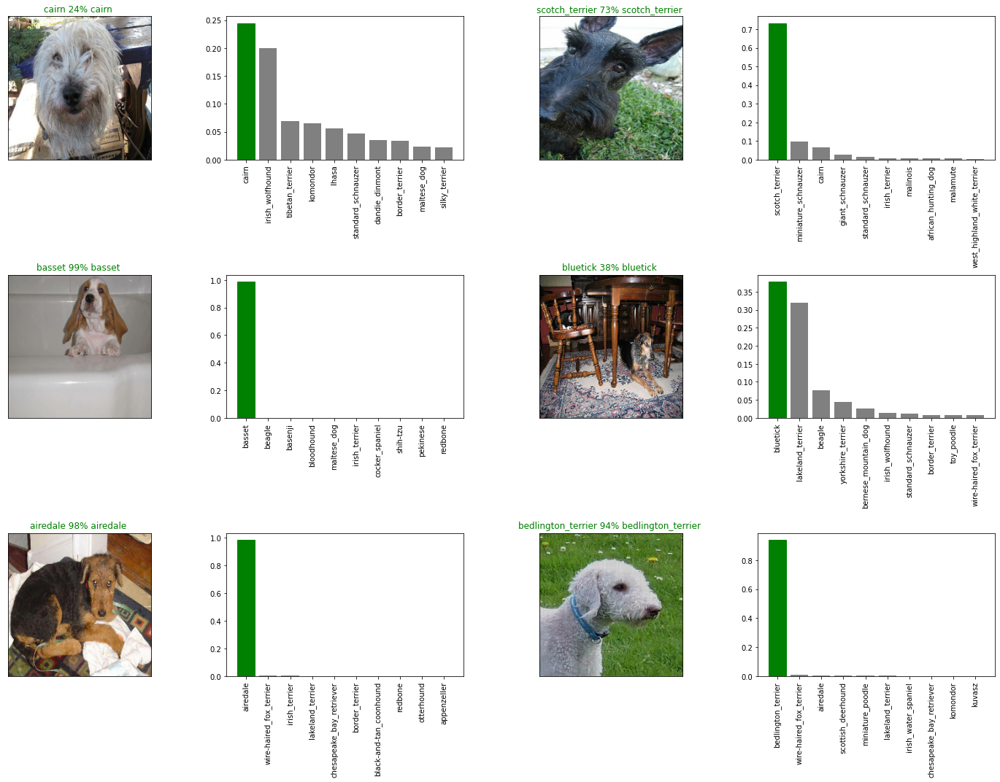

In [67]:
# Let's check a few predictions and their different values
i_multiplier = 0
num_rows = 3
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize=(5*2*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=val_labels,
            images=val_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                labels=val_labels,
                n=i+i_multiplier)
plt.tight_layout(h_pad=1.0)
plt.show()

In [68]:
# Function to plot predictions and their different values
def plot_multiple_pred(i_multiplier, num_rows, num_cols):
  num_images = num_rows*num_cols
  plt.figure(figsize=(5*2*num_cols, 5*num_rows))
  for i in range(num_images):
    plt.subplot(num_rows, 2*num_cols, 2*i+1)
    plot_pred(prediction_probabilities=predictions,
              labels=val_labels,
              images=val_images,
              n=i+i_multiplier)
    plt.subplot(num_rows, 2*num_cols, 2*i+2)
    plot_pred_conf(prediction_probabilities=predictions,
                  labels=val_labels,
                  n=i+i_multiplier)
  plt.tight_layout(h_pad=1.0)
  plt.show()  

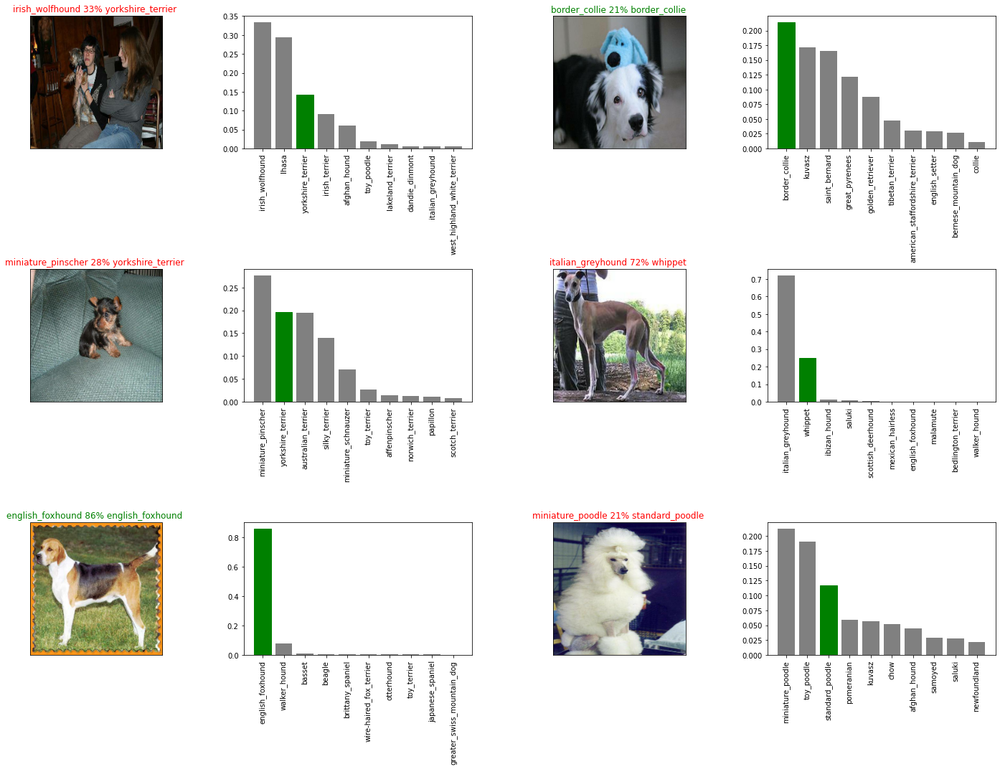

In [69]:
plot_multiple_pred(10, 3, 2)

## Confusion Matrix

A confusion matrix is a visual way to show where your model made the right predictions and where it made the wrong predictions (or in other words, got confused)

In [70]:
# # For loop to get pred label array
# for i in len(val_lab)

# # Display confusion matrix using confusion_matrix()
# pred_label = get_pred_label(pred_prob)
# print(confusion_matrix(val_labels))

## Saving and reloading a trained model

In [71]:
# Create a function to save a model
def save_model(model, suffix=None):
  """
  Saves a given model in a models directory and appends a suffix (string).
  """
  # Create a model directory pathname with current time
  modeldir = os.path.join("drive/My Drive/Dog Vision/models",
                          datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))
  model_path = modeldir + "-" + suffix + ".h5" # save format of model
  print(f"Saving model to: {model_path}...")
  model.save(model_path)
  return model_path

In [72]:
# Create a function to load a trained model
def load_model(model_path):
  """
  Loads a saved model from a specified path.
  """
  print(f"Loading saved model from: {model_path}")
  model = tf.keras.models.load_model(model_path, 
                                     custom_objects={"KerasLayer":hub.KerasLayer})
  return model

Now we've got functions to save and load a trained model, let's make sure they work!

In [73]:
# Save our model trained on 1000 images
save_model(model, suffix="1000-images-mobilenetv2-Adam")

Saving model to: drive/My Drive/Dog Vision/models/20221101-05161667279798-1000-images-mobilenetv2-Adam.h5...


'drive/My Drive/Dog Vision/models/20221101-05161667279798-1000-images-mobilenetv2-Adam.h5'

In [74]:
# Load a trained model
loaded_1000_image_model = load_model("drive/MyDrive/Dog Vision/models/20221002-09581664704682-1000-images-mobilenetv2-Adam.h5")

Loading saved model from: drive/MyDrive/Dog Vision/models/20221002-09581664704682-1000-images-mobilenetv2-Adam.h5


In [75]:
# Evaluate the pre-saved model
model.evaluate(validation_batch)

7/7 [==============================] - 1s 88ms/step - loss: 1.1784 - accuracy: 0.6950


[1.1784149408340454, 0.6949999928474426]

In [76]:
# Evaluate the loaded model
loaded_1000_image_model.evaluate(validation_batch)

7/7 [==============================] - 2s 218ms/step - loss: 1.2141 - accuracy: 0.7050


[1.2141358852386475, 0.7049999833106995]

## Training a model (on the full data)
Now we know our model works on a subset of the data, we can start to move forward with training one on the full data.

Above, we saved all of the training filepaths to `X` and all of the training labels to `y`. Let's check them out.

In [77]:
# The size of the full dataset
len(X), len(y)

(10222, 10222)

We've got over 10,000 images and labels in our training set.

Before we can train a model on these, we'll have to turn them into a **data batch**.

We can use our `create_data_batches()` function from above which also preprocesses our images for us.

In [78]:
# Turn full training data in a data batch
full_data = create_data_batches(X, y)

Creating training data batches!!


Now let's use `create_model()` to instantiate another model.

In [79]:
# Instantiate a new model for training on the full dataset
full_model = create_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4


Now we need some callbacks too.

In [80]:
# Create full model callbacks

# TensorBoard callback
full_model_tensorboard = create_tensorboard_callback()

# Early stopping callback
# Note: No validation set when training on all the data, therefore can't monitor validation accruacy
full_model_early_stopping = tf.keras.callbacks.EarlyStopping(monitor="accuracy",
                                                             patience=3)

To monitor the model whilst it trains, we will load TensorBoard (it should update every 30-seconds or so whilst the model trains).

In [83]:
%tensorboard --logdir drive/MyDrive/Dog\ Vision/logs

Reusing TensorBoard on port 6006 (pid 10112), started 0:22:17 ago. (Use '!kill 10112' to kill it.)

<IPython.core.display.Javascript object>

Since running the cell below will cause the model to train on all of the data (10,000+) images, it may take a fairly long time to get started and finish. 

However, we have 
`full_model_early_stopping` callback, it'll stop before it starts going too long.

The first epoch is always the longest as data gets loaded into memory. After it's there, it'll speed up.

In [84]:
# Fit the full model to the full training data
full_model.fit(x=full_data,
               epochs=NUM_EPOCH,
               callbacks=[full_model_tensorboard, 
                          full_model_early_stopping])

Epoch 1/100
320/320 [==============================] - 45s 130ms/step - loss: 1.3566 - accuracy: 0.6660
Epoch 2/100
320/320 [==============================] - 39s 122ms/step - loss: 0.4019 - accuracy: 0.8820
Epoch 3/100
320/320 [==============================] - 38s 119ms/step - loss: 0.2396 - accuracy: 0.9335
Epoch 4/100
320/320 [==============================] - 36s 112ms/step - loss: 0.1559 - accuracy: 0.9623
Epoch 5/100
320/320 [==============================] - 40s 125ms/step - loss: 0.1098 - accuracy: 0.9781
Epoch 6/100
320/320 [==============================] - 41s 127ms/step - loss: 0.0786 - accuracy: 0.9865
Epoch 7/100
320/320 [==============================] - 38s 119ms/step - loss: 0.0578 - accuracy: 0.9925
Epoch 8/100
320/320 [==============================] - 40s 125ms/step - loss: 0.0470 - accuracy: 0.9936
Epoch 9/100
320/320 [==============================] - 37s 117ms/step - loss: 0.0376 - accuracy: 0.9957
Epoch 10/100
320/320 [==============================] - 44s 137m

## Saving and reloading the full model
We can do so using our `save_model()` function.

In [85]:
# Save model to file
save_model(full_model, suffix="all-images-Adam")

Saving model to: drive/My Drive/Dog Vision/models/20221101-06061667282796-all-images-Adam.h5...


'drive/My Drive/Dog Vision/models/20221101-06061667282796-all-images-Adam.h5'

In [86]:
# Load in the full model
loaded_full_model = load_model("drive/My Drive/Dog Vision/models/20221101-06061667282796-all-images-Adam.h5")

Loading saved model from: drive/My Drive/Dog Vision/models/20221101-06061667282796-all-images-Adam.h5


## Making predictions on the test dataset

Since our model has been trained on images in the form of Tensor batches, to make predictions on the test data, we'll have to get it into the same format.

To make predictions on the test data, we'll:

* Get the test image filenames.
* Convert the filenames into test data batches using `create_data_batches()` and setting the `test_data` parameter to `True` (since there are no labels with the test images).
* Make a predictions array by passing the test data batches to the `predict()` function.

In [93]:
# Load test image filenames (since we're using os.listdir(), these already have .jpg)
test_path = "drive/MyDrive/Dog Vision/Dog-Breed/test/"
test_filenames = [test_path + fname for fname in os.listdir(test_path)]

test_filenames[:5]

['drive/MyDrive/Dog Vision/Dog-Breed/test/e73d52671c56e1507fed58c4c287d5f1.jpg',
 'drive/MyDrive/Dog Vision/Dog-Breed/test/e8eca3dc497d4bb15b0254bc9f56cdd7.jpg',
 'drive/MyDrive/Dog Vision/Dog-Breed/test/e864f3fc5d19aec4b7a5aa547b359c57.jpg',
 'drive/MyDrive/Dog Vision/Dog-Breed/test/e806a67a05289ac6de6831001664b81b.jpg',
 'drive/MyDrive/Dog Vision/Dog-Breed/test/e7e9dd51302fe08c1c89a550e183cf07.jpg']

In [94]:
# How many test images are there?
len(test_filenames)

10357

In [95]:
# Create test data batch
test_data = create_data_batches(test_filenames, test_data=True)

Creating test data batches!!


Since there are 10,000+ test images, making predictions could take a while, even on a GPU. So running the cell below may take up to an hour.

In [96]:
# Make predictions on test data batch using the loaded full model
test_predictions = loaded_full_model.predict(test_data,
                                             verbose=1)

324/324 [==============================] - 227s 654ms/step


In [97]:
# Check out the test predictions
test_predictions[:10]

array([[1.1257313e-10, 3.1357255e-13, 6.2374433e-13, ..., 4.6130773e-12,
        3.8622648e-13, 8.5291691e-13],
       [3.4355765e-11, 2.0960872e-08, 2.9701616e-10, ..., 5.1121568e-10,
        1.8184865e-06, 9.5102157e-09],
       [1.2778663e-08, 5.5665108e-08, 5.9291450e-13, ..., 2.9853378e-10,
        2.4360654e-13, 7.4063125e-12],
       ...,
       [1.2340597e-10, 3.0639620e-09, 4.5496037e-11, ..., 1.5123081e-09,
        8.8955864e-11, 1.3974043e-11],
       [3.2212251e-09, 6.9581489e-08, 1.7860281e-09, ..., 3.0994827e-09,
        2.5088579e-07, 5.1219146e-08],
       [1.5269171e-11, 1.5145118e-07, 2.8521505e-11, ..., 8.3081923e-06,
        1.7019296e-09, 7.9141719e-12]], dtype=float32)

## Preparing test dataset predictions for Kaggle

In [98]:
# Create pandas DataFrame with empty columns
preds_df = pd.DataFrame(columns=["id"] + list(unique_breeds))
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier


In [99]:
# Append test image ID's to predictions DataFrame
test_path = "drive/MyDrive/Dog Vision/Dog-Breed/test/"
preds_df["id"] = [os.path.splitext(path)[0] for path in os.listdir(test_path)]
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,e73d52671c56e1507fed58c4c287d5f1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,e8eca3dc497d4bb15b0254bc9f56cdd7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,e864f3fc5d19aec4b7a5aa547b359c57,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,e806a67a05289ac6de6831001664b81b,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,e7e9dd51302fe08c1c89a550e183cf07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [100]:
# Add the prediction probabilities to each dog breed column
preds_df[list(unique_breeds)] = test_predictions
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,e73d52671c56e1507fed58c4c287d5f1,1.125731e-10,3.135725e-13,6.237443e-13,6.391581e-11,4.492150e-12,1.689209e-06,3.758605e-12,8.462459e-12,5.091953e-12,...,1.413743e-10,1.488441e-14,1.715016e-11,9.205944e-12,3.906905e-13,2.286243e-10,3.562971e-11,4.613077e-12,3.862265e-13,8.529169e-13
1,e8eca3dc497d4bb15b0254bc9f56cdd7,3.435576e-11,2.096087e-08,2.970162e-10,1.816816e-09,8.544572e-08,6.158143e-09,1.833653e-08,2.274382e-09,8.104695e-12,...,1.200845e-08,1.804483e-10,5.441777e-11,5.557268e-09,3.849291e-12,3.940642e-08,7.661313e-10,5.112157e-10,1.818486e-06,9.510216e-09
2,e864f3fc5d19aec4b7a5aa547b359c57,1.277866e-08,5.566511e-08,5.929145e-13,1.197274e-10,9.550583e-14,1.518433e-12,1.620451e-11,2.965174e-11,1.227674e-13,...,2.638078e-09,2.779430e-15,7.079328e-14,5.268783e-10,1.041061e-10,4.356150e-11,3.022948e-14,2.985338e-10,2.436065e-13,7.406313e-12
3,e806a67a05289ac6de6831001664b81b,1.171522e-17,1.921473e-08,6.434108e-15,5.957962e-14,1.308304e-17,5.331519e-15,1.097250e-14,5.986205e-16,6.387598e-10,...,3.306291e-14,2.499834e-15,4.756906e-12,1.680245e-13,1.250314e-13,1.819933e-15,1.073377e-17,2.943597e-12,1.864193e-15,5.252420e-14
4,e7e9dd51302fe08c1c89a550e183cf07,1.879579e-03,3.177115e-08,1.010004e-08,1.507382e-07,1.438502e-07,2.708355e-09,6.780878e-02,2.795762e-08,8.438043e-10,...,2.074883e-07,8.645640e-04,4.379364e-09,1.974502e-10,4.148822e-09,2.662070e-10,3.727678e-06,6.620299e-08,1.719957e-06,9.222649e-01


In [101]:
# export predictions DataFrame to CSV so we can submit it to Kaggle.
preds_df.to_csv("drive/MyDrive/Dog Vision/Dog-Breed/full_submission_1_mobilienetV2_adam.csv",
                 index=False)